<a href="https://colab.research.google.com/github/ahmadtulsi/plantclassification-kmmi/blob/main/Capstone%20Project-Plant%20Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Notebook sudah saya ubah ke Public

In [ ]:
#!gdown --id 1kKMz2jWygTWffnbvnBQkxHmOL5CBIaI4
!gdown --id 1otNC5RKPeG49G_XV0KR4HM7Vf9hLl-ur

Downloading...
From: https://drive.google.com/uc?id=1otNC5RKPeG49G_XV0KR4HM7Vf9hLl-ur
To: /content/dataset_plant.zip
110MB [00:00, 179MB/s] 


In [ ]:
!unzip /content/plant_classify.zip

In [ ]:
!unzip /content/dataset_plant.zip -d /content/component

Archive:  /content/dataset_plant.zip
   creating: /content/component/dataset/
  inflating: /content/component/dataset/.DS_Store  
  inflating: /content/component/__MACOSX/dataset/._.DS_Store  
   creating: /content/component/dataset/images/
   creating: /content/component/dataset/masks/
  inflating: /content/component/dataset/images/image_crocus_0002.png  
  inflating: /content/component/dataset/images/image_crocus_0016.png  
  inflating: /content/component/dataset/images/image_sunflower_0119.png  
  inflating: /content/component/dataset/images/image_sunflower_0092.png  
  inflating: /content/component/dataset/images/image_sunflower_0086.png  
  inflating: /content/component/dataset/images/image_daisy_0131.png  
  inflating: /content/component/dataset/images/image_sunflower_0051.png  
  inflating: /content/component/dataset/images/image_daisy_0125.png  
  inflating: /content/component/dataset/images/image_sunflower_0079.png  
  inflating: /content/component/dataset/images/image_sunflow

In [ ]:
!python classify.py -i /content/dataset/dataset/images -m /content/dataset/dataset/masks

              precision    recall  f1-score   support

      crocus       0.92      1.00      0.96        12
       daisy       0.88      0.93      0.90        15
       pansy       1.00      0.85      0.92        20
   sunflower       0.96      1.00      0.98        24

    accuracy                           0.94        71
   macro avg       0.94      0.95      0.94        71
weighted avg       0.95      0.94      0.94        71

/content/dataset/dataset/images/image_daisy_0176.png
I think this flower is a DAISY
: cannot connect to X server 


In [ ]:
!python classify_svm.py -i /content/dataset/dataset/images -m /content/dataset/dataset/masks

              precision    recall  f1-score   support

      crocus       0.70      0.58      0.64        12
       daisy       0.86      0.80      0.83        15
       pansy       0.81      0.85      0.83        20
   sunflower       0.92      1.00      0.96        24

    accuracy                           0.85        71
   macro avg       0.82      0.81      0.81        71
weighted avg       0.84      0.85      0.84        71

/content/dataset/dataset/images/image_crocus_0022.png
I think this flower is a CROCUS
: cannot connect to X server 


Contoh yang diberikan ada pada file classify.py. Dengan menggunakan contoh tersebut saya mencoba membuat dropdown menu yang berisi list dari beberapa model, sehingga bisa mempermudah melakukan eksperimen.


In [ ]:
# USAGE
# python classify.py --images dataset/images --masks dataset/masks

# import the necessary packages
from __future__ import print_function
from component.rgbhistogram import RGBHistogram
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import numpy as np
import argparse
import glob
import cv2
# Import model list
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression

#@title Klasifikasi menggunakan Machine Learning
image = '/content/dataset/dataset/images' #@param
mask = '/content/dataset/dataset/masks' #@param
list_model = SVC #@param ["SVC", "RandomForestClassifier", "KNeighborsClassifier", "MultinomialNB", "DecisionTreeClassifier", "LogisticRegression"] {type:"raw"}
#@markdown ---


# grab the image and mask paths
imagePaths = sorted(glob.glob(image + "/*.png"))
maskPaths = sorted(glob.glob(mask + "/*.png"))

# initialize the list of data and class label targets
data = []
target = []

# initialize the image descriptor
desc = RGBHistogram([8, 8, 8])

# loop over the image and mask paths
for (imagePath, maskPath) in zip(imagePaths, maskPaths):
	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# update the list of data and targets
	data.append(features)
	target.append(imagePath.split("_")[-2])

# grab the unique target names and encode the labels
targetNames = np.unique(target)
le = LabelEncoder()
target = le.fit_transform(target)

# construct the training and testing splits
(trainData, testData, trainTarget, testTarget) = train_test_split(data, target,
	test_size = 0.3, random_state = 42)


# train the classifier
model = list_model()
model.fit(trainData, trainTarget)

# evaluate the classifier
print(classification_report(testTarget, model.predict(testData),
	target_names = targetNames))

# loop over a sample of the images
for i in np.random.choice(np.arange(0, len(imagePaths)), 10):
	# grab the image and mask paths
	imagePath = imagePaths[i]
	maskPath = maskPaths[i]

	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# predict what type of flower the image is
	flower = le.inverse_transform(model.predict([features]))[0]
	print(imagePath)
	print("I think this flower is a {}".format(flower.upper()))
	cv2.imshow(image)
	cv2.waitKey(0)

              precision    recall  f1-score   support

      crocus       0.70      0.58      0.64        12
       daisy       0.86      0.80      0.83        15
       pansy       0.81      0.85      0.83        20
   sunflower       0.92      1.00      0.96        24

    accuracy                           0.85        71
   macro avg       0.82      0.81      0.81        71
weighted avg       0.84      0.85      0.84        71

/content/dataset/dataset/images/image_daisy_0132.png
I think this flower is a DAISY


DisabledFunctionError: ignored

Terjadi error, sehingga tidak bisa menampilkan gambar di jupyter notebook. Dari error tersebut sudah ada solusinya, yaitu menggunakan cv2_imshow dari package google.colab.

              precision    recall  f1-score   support

      crocus       0.70      0.58      0.64        12
       daisy       0.86      0.80      0.83        15
       pansy       0.81      0.85      0.83        20
   sunflower       0.92      1.00      0.96        24

    accuracy                           0.85        71
   macro avg       0.82      0.81      0.81        71
weighted avg       0.84      0.85      0.84        71

/content/dataset/dataset/images/image_crocus_0004.png
I think this flower is a CROCUS


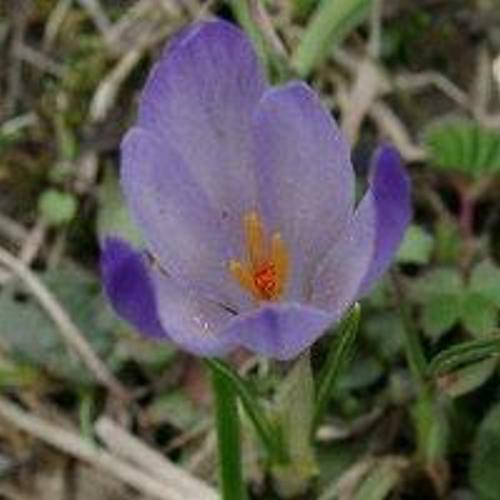

/content/dataset/dataset/images/image_pansy_0207.png
I think this flower is a PANSY


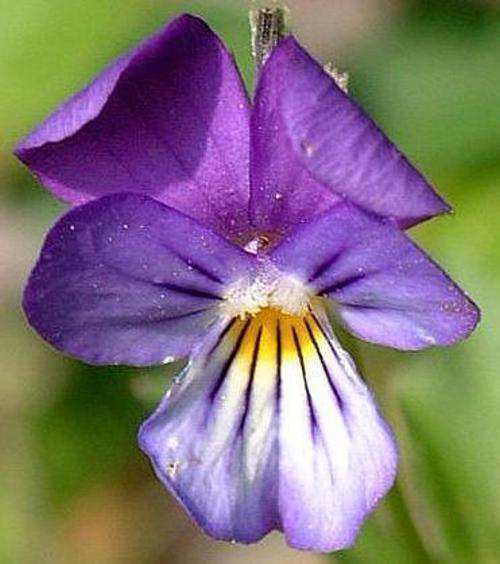

/content/dataset/dataset/images/image_sunflower_0121.png
I think this flower is a SUNFLOWER


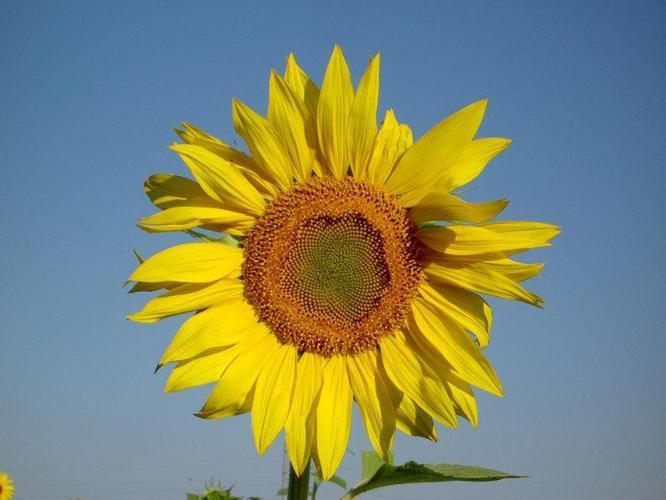

/content/dataset/dataset/images/image_sunflower_0118.png
I think this flower is a SUNFLOWER


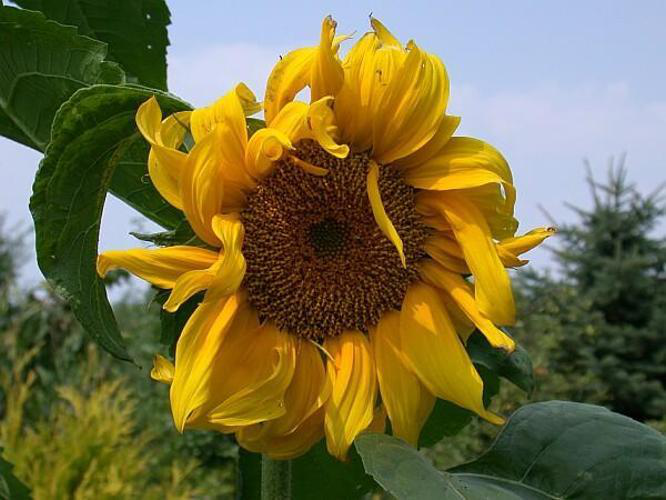

/content/dataset/dataset/images/image_sunflower_0108.png
I think this flower is a SUNFLOWER


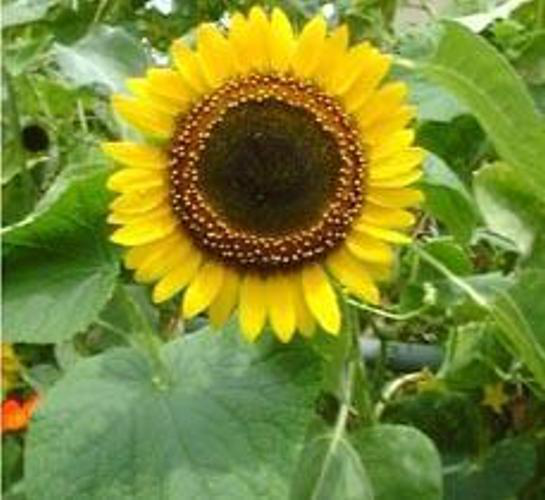

/content/dataset/dataset/images/image_sunflower_0054.png
I think this flower is a SUNFLOWER


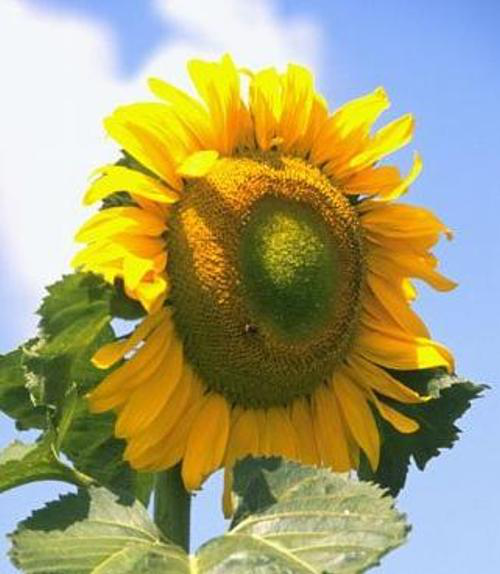

/content/dataset/dataset/images/image_crocus_0050.png
I think this flower is a CROCUS


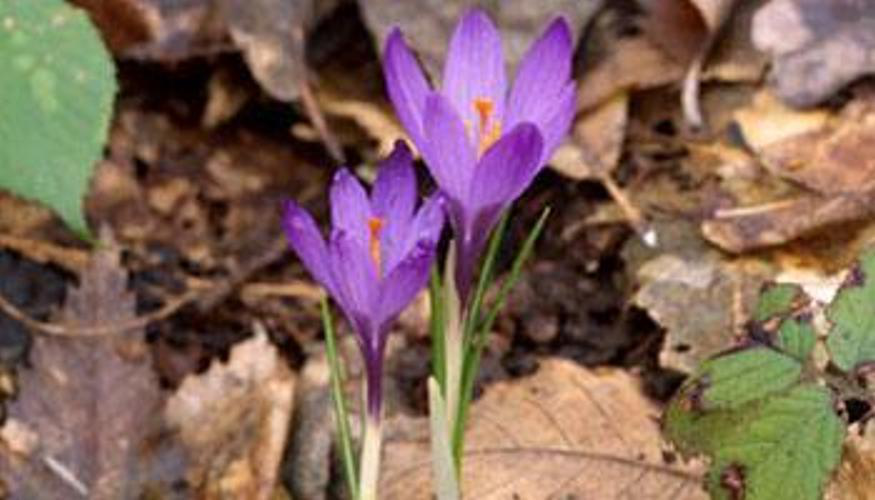

/content/dataset/dataset/images/image_pansy_0222.png
I think this flower is a PANSY


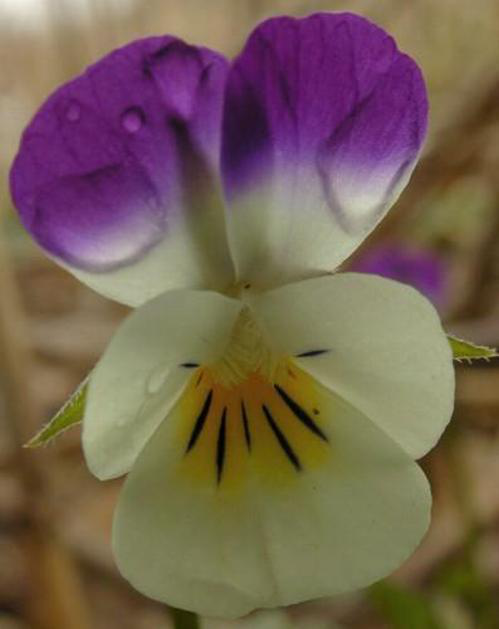

/content/dataset/dataset/images/image_sunflower_0102.png
I think this flower is a SUNFLOWER


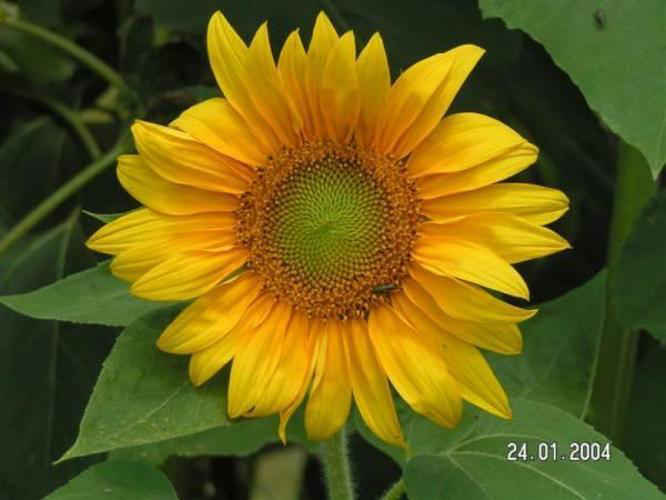

/content/dataset/dataset/images/image_pansy_0183.png
I think this flower is a PANSY


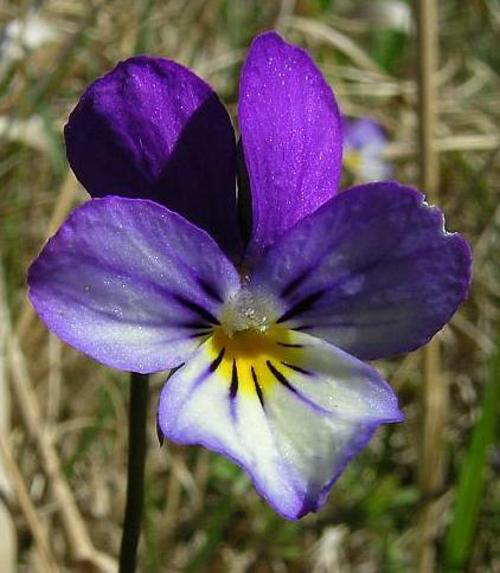

In [ ]:
# USAGE
# python classify.py --images dataset/images --masks dataset/masks

# import the necessary packages
from __future__ import print_function
from component.rgbhistogram import RGBHistogram
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import numpy as np
import argparse
import glob
import cv2
from google.colab.patches import cv2_imshow
# Import model list
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression

#@title Klasifikasi menggunakan Machine Learning
image = '/content/dataset/dataset/images' #@param
mask = '/content/dataset/dataset/masks' #@param
list_model = SVC #@param ["SVC", "RandomForestClassifier", "KNeighborsClassifier", "MultinomialNB", "DecisionTreeClassifier", "LogisticRegression"] {type:"raw"}
#@markdown ---


# grab the image and mask paths
imagePaths = sorted(glob.glob(image + "/*.png"))
maskPaths = sorted(glob.glob(mask + "/*.png"))

# initialize the list of data and class label targets
data = []
target = []

# initialize the image descriptor
desc = RGBHistogram([8, 8, 8])

# loop over the image and mask paths
for (imagePath, maskPath) in zip(imagePaths, maskPaths):
	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# update the list of data and targets
	data.append(features)
	target.append(imagePath.split("_")[-2])

# grab the unique target names and encode the labels
targetNames = np.unique(target)
le = LabelEncoder()
target = le.fit_transform(target)

# construct the training and testing splits
(trainData, testData, trainTarget, testTarget) = train_test_split(data, target,
	test_size = 0.3, random_state = 42)


# train the classifier
model = list_model()
model.fit(trainData, trainTarget)

# evaluate the classifier
print(classification_report(testTarget, model.predict(testData),
	target_names = targetNames))

# loop over a sample of the images
for i in np.random.choice(np.arange(0, len(imagePaths)), 10):
	# grab the image and mask paths
	imagePath = imagePaths[i]
	maskPath = maskPaths[i]

	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# predict what type of flower the image is
	flower = le.inverse_transform(model.predict([features]))[0]
	print(imagePath)
	print("I think this flower is a {}".format(flower.upper()))
	cv2_imshow(image)
	cv2.waitKey(0)

              precision    recall  f1-score   support

      crocus       1.00      1.00      1.00        12
       daisy       0.88      1.00      0.94        15
       pansy       1.00      0.85      0.92        20
   sunflower       0.96      1.00      0.98        24

    accuracy                           0.96        71
   macro avg       0.96      0.96      0.96        71
weighted avg       0.96      0.96      0.96        71

/content/dataset/dataset/images/image_crocus_0019.png
I think this flower is a CROCUS


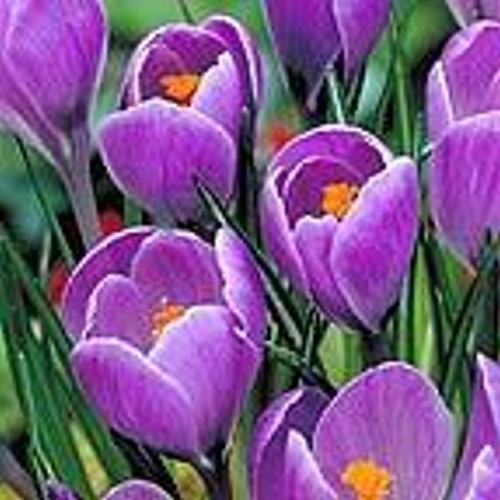

/content/dataset/dataset/images/image_crocus_0003.png
I think this flower is a CROCUS


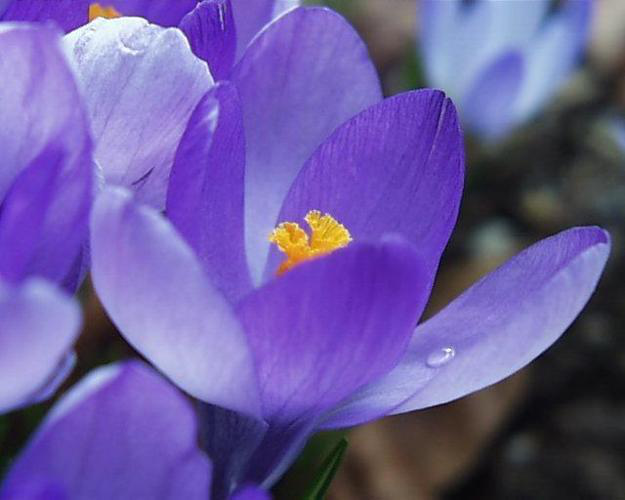

/content/dataset/dataset/images/image_crocus_0015.png
I think this flower is a CROCUS


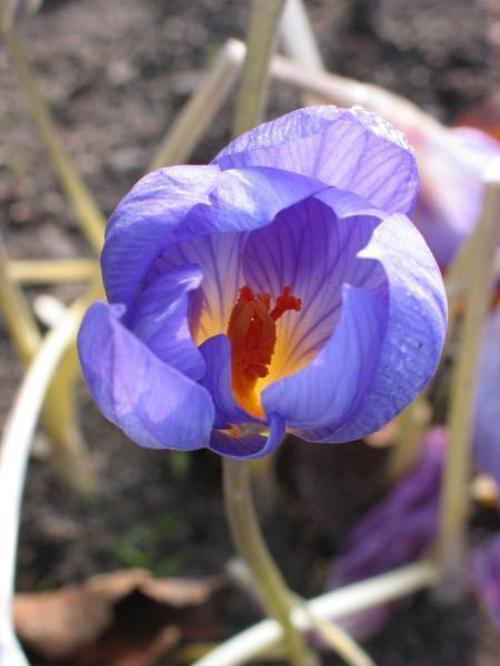

/content/dataset/dataset/images/image_pansy_0180.png
I think this flower is a PANSY


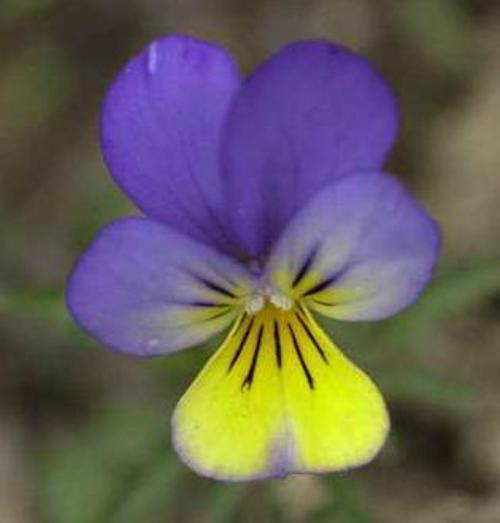

/content/dataset/dataset/images/image_daisy_0159.png
I think this flower is a DAISY


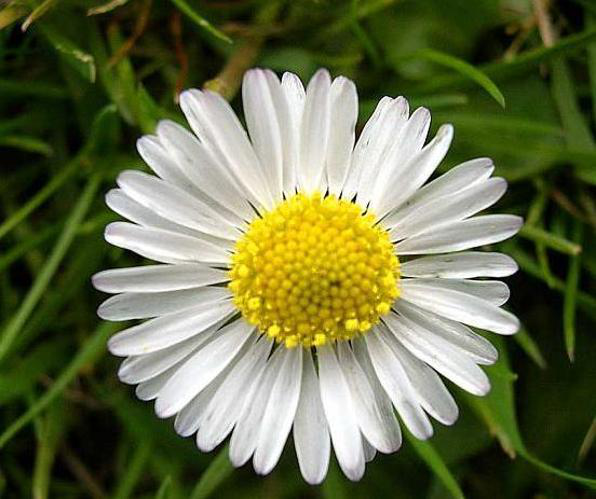

/content/dataset/dataset/images/image_sunflower_0111.png
I think this flower is a SUNFLOWER


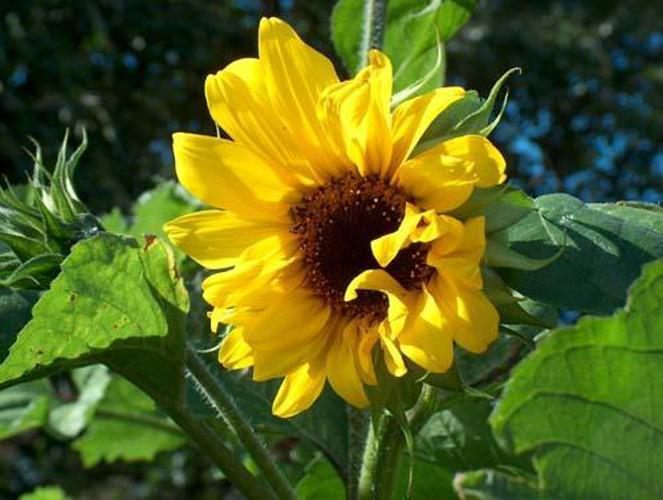

/content/dataset/dataset/images/image_daisy_0177.png
I think this flower is a DAISY


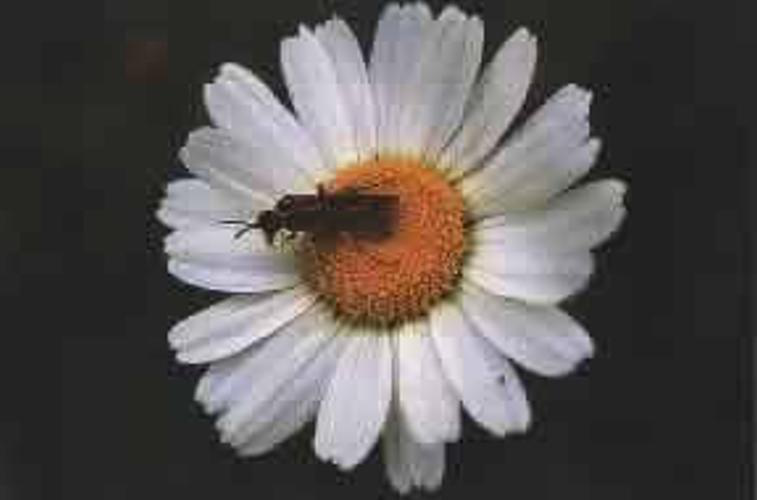

/content/dataset/dataset/images/image_pansy_0205.png
I think this flower is a PANSY


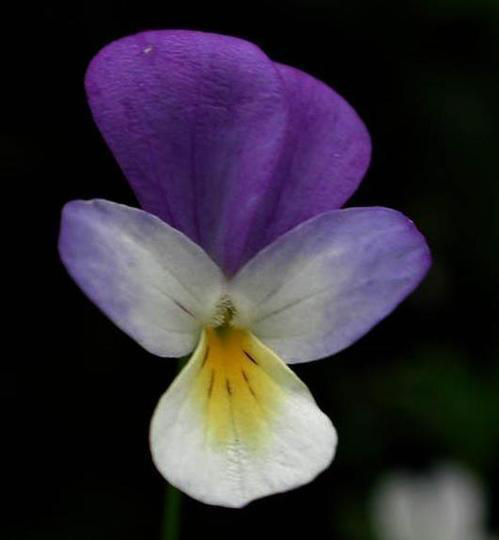

/content/dataset/dataset/images/image_crocus_0031.png
I think this flower is a CROCUS


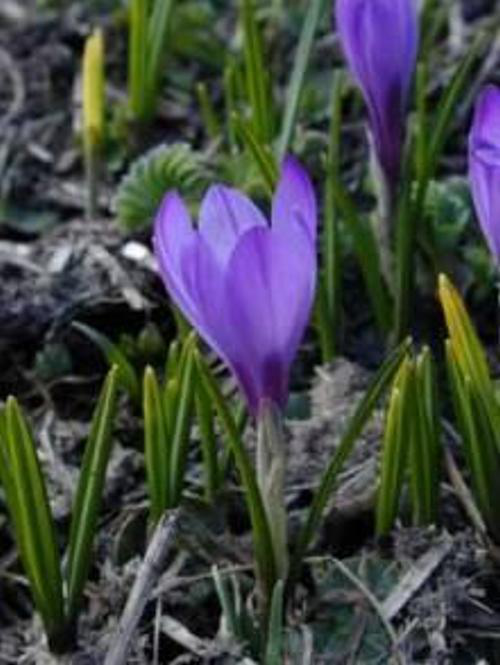

/content/dataset/dataset/images/image_sunflower_0070.png
I think this flower is a SUNFLOWER


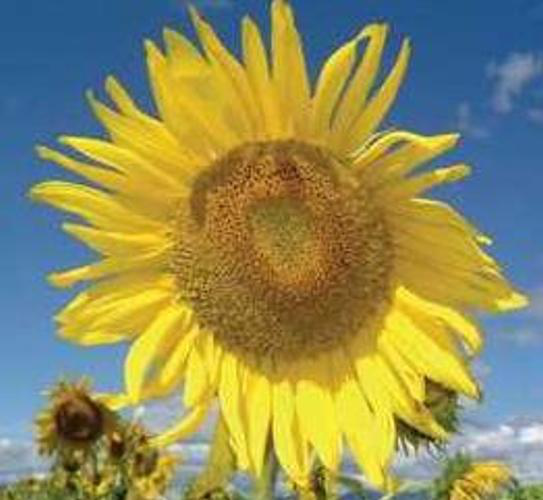

In [ ]:
# USAGE
# python classify.py --images dataset/images --masks dataset/masks

# import the necessary packages
from __future__ import print_function
from component.rgbhistogram import RGBHistogram
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import numpy as np
import argparse
import glob
import cv2
from google.colab.patches import cv2_imshow
# Import model list
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression

#@title Klasifikasi menggunakan Machine Learning
image = '/content/dataset/dataset/images' #@param
mask = '/content/dataset/dataset/masks' #@param
list_model = RandomForestClassifier #@param ["SVC", "RandomForestClassifier", "KNeighborsClassifier", "MultinomialNB", "DecisionTreeClassifier", "LogisticRegression"] {type:"raw"}
#@markdown ---


# grab the image and mask paths
imagePaths = sorted(glob.glob(image + "/*.png"))
maskPaths = sorted(glob.glob(mask + "/*.png"))

# initialize the list of data and class label targets
data = []
target = []

# initialize the image descriptor
desc = RGBHistogram([8, 8, 8])

# loop over the image and mask paths
for (imagePath, maskPath) in zip(imagePaths, maskPaths):
	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# update the list of data and targets
	data.append(features)
	target.append(imagePath.split("_")[-2])

# grab the unique target names and encode the labels
targetNames = np.unique(target)
le = LabelEncoder()
target = le.fit_transform(target)

# construct the training and testing splits
(trainData, testData, trainTarget, testTarget) = train_test_split(data, target,
	test_size = 0.3, random_state = 42)


# train the classifier
model = list_model()
model.fit(trainData, trainTarget)

# evaluate the classifier
print(classification_report(testTarget, model.predict(testData),
	target_names = targetNames))

# loop over a sample of the images
for i in np.random.choice(np.arange(0, len(imagePaths)), 10):
	# grab the image and mask paths
	imagePath = imagePaths[i]
	maskPath = maskPaths[i]

	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# predict what type of flower the image is
	flower = le.inverse_transform(model.predict([features]))[0]
	print(imagePath)
	print("I think this flower is a {}".format(flower.upper()))
	cv2_imshow(image)
	cv2.waitKey(0)

              precision    recall  f1-score   support

      crocus       0.43      0.50      0.46        12
       daisy       0.64      0.93      0.76        15
       pansy       0.75      0.30      0.43        20
   sunflower       0.89      1.00      0.94        24

    accuracy                           0.70        71
   macro avg       0.68      0.68      0.65        71
weighted avg       0.72      0.70      0.68        71

/content/dataset/dataset/images/image_crocus_0027.png
I think this flower is a CROCUS


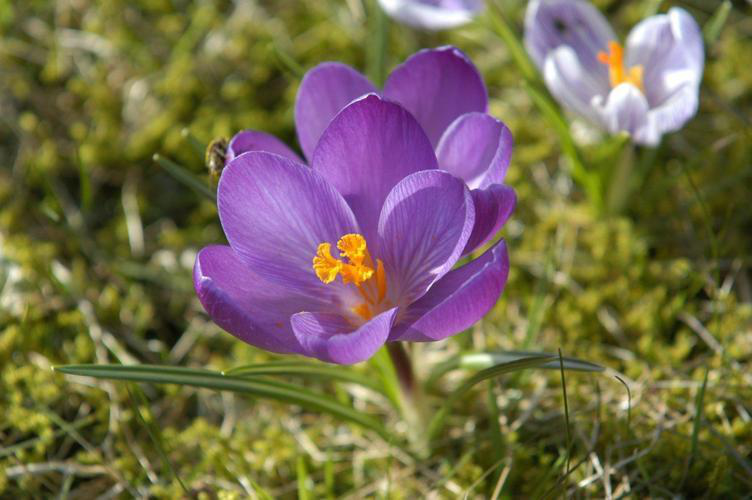

/content/dataset/dataset/images/image_sunflower_0109.png
I think this flower is a SUNFLOWER


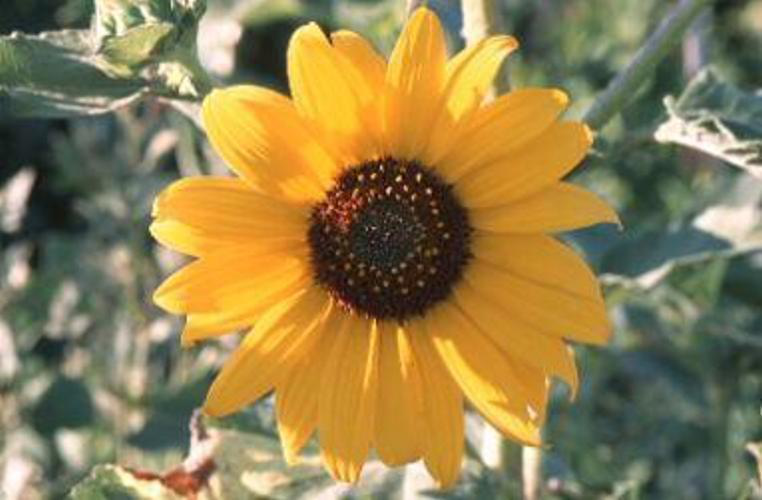

/content/dataset/dataset/images/image_pansy_0189.png
I think this flower is a PANSY


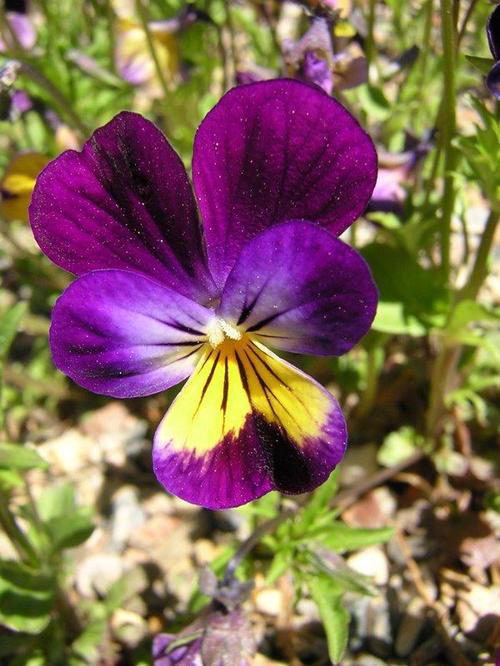

/content/dataset/dataset/images/image_crocus_0033.png
I think this flower is a DAISY


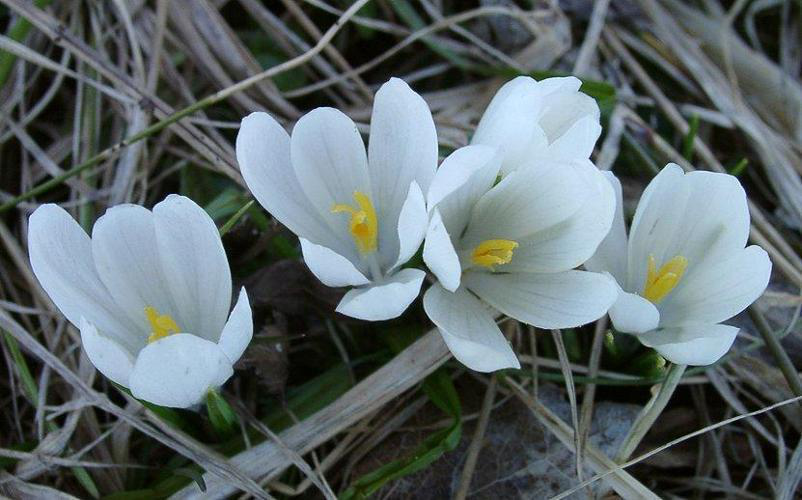

/content/dataset/dataset/images/image_sunflower_0108.png
I think this flower is a SUNFLOWER


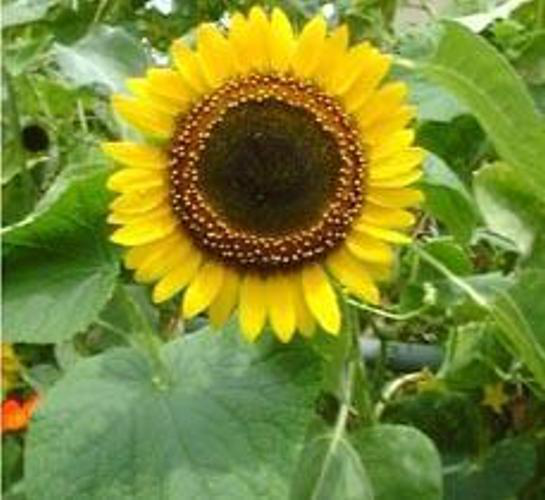

/content/dataset/dataset/images/image_daisy_0148.png
I think this flower is a DAISY


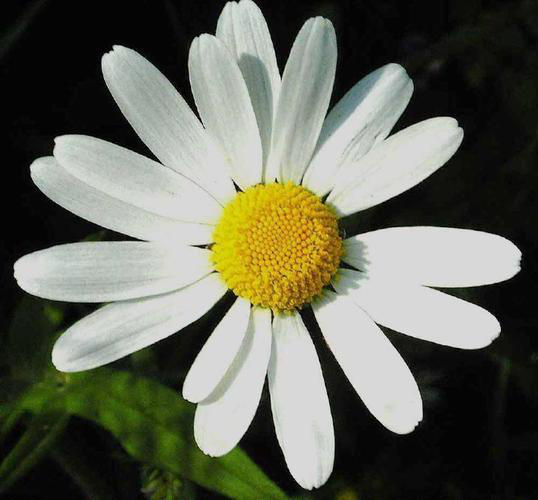

/content/dataset/dataset/images/image_pansy_0224.png
I think this flower is a PANSY


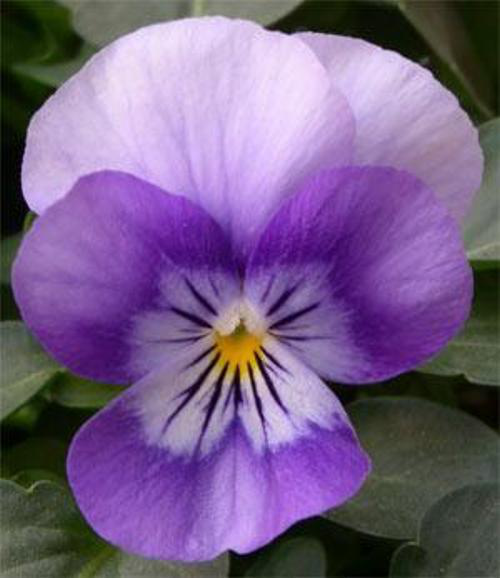

/content/dataset/dataset/images/image_daisy_0143.png
I think this flower is a DAISY


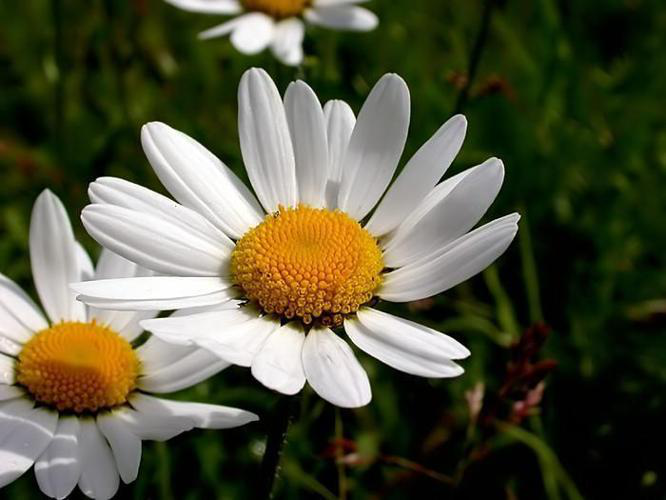

/content/dataset/dataset/images/image_daisy_0170.png
I think this flower is a DAISY


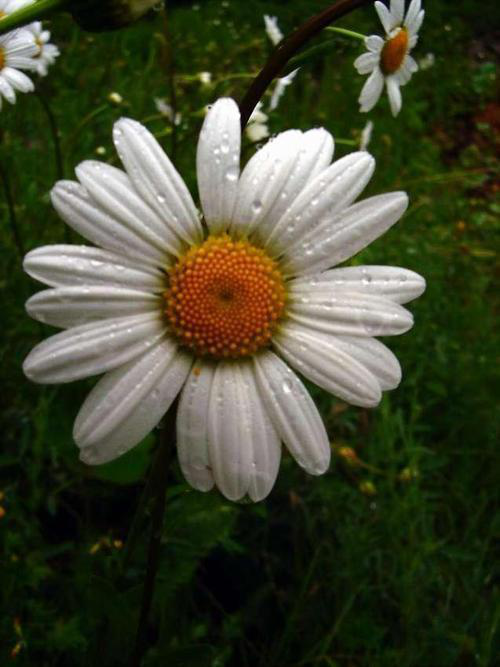

/content/dataset/dataset/images/image_crocus_0029.png
I think this flower is a DAISY


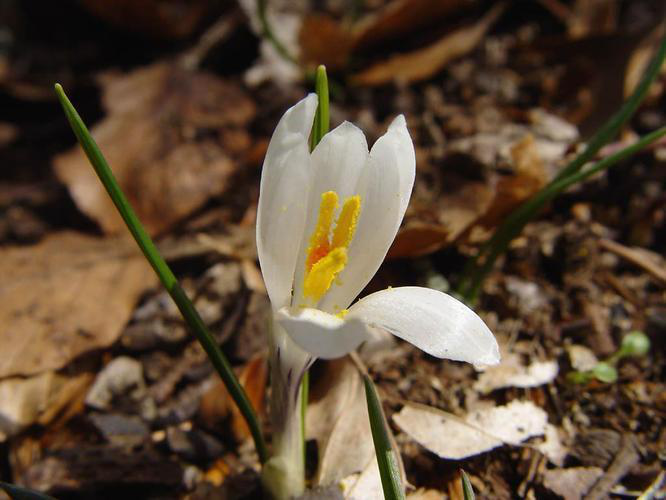

In [ ]:
# USAGE
# python classify.py --images dataset/images --masks dataset/masks

# import the necessary packages
from __future__ import print_function
from component.rgbhistogram import RGBHistogram
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import numpy as np
import argparse
import glob
import cv2
from google.colab.patches import cv2_imshow
# Import model list
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression

#@title Klasifikasi menggunakan Machine Learning
image = '/content/dataset/dataset/images' #@param
mask = '/content/dataset/dataset/masks' #@param
list_model = KNeighborsClassifier #@param ["SVC", "RandomForestClassifier", "KNeighborsClassifier", "MultinomialNB", "DecisionTreeClassifier", "LogisticRegression"] {type:"raw"}
#@markdown ---


# grab the image and mask paths
imagePaths = sorted(glob.glob(image + "/*.png"))
maskPaths = sorted(glob.glob(mask + "/*.png"))

# initialize the list of data and class label targets
data = []
target = []

# initialize the image descriptor
desc = RGBHistogram([8, 8, 8])

# loop over the image and mask paths
for (imagePath, maskPath) in zip(imagePaths, maskPaths):
	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# update the list of data and targets
	data.append(features)
	target.append(imagePath.split("_")[-2])

# grab the unique target names and encode the labels
targetNames = np.unique(target)
le = LabelEncoder()
target = le.fit_transform(target)

# construct the training and testing splits
(trainData, testData, trainTarget, testTarget) = train_test_split(data, target,
	test_size = 0.3, random_state = 42)


# train the classifier
model = list_model()
model.fit(trainData, trainTarget)

# evaluate the classifier
print(classification_report(testTarget, model.predict(testData),
	target_names = targetNames))

# loop over a sample of the images
for i in np.random.choice(np.arange(0, len(imagePaths)), 10):
	# grab the image and mask paths
	imagePath = imagePaths[i]
	maskPath = maskPaths[i]

	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# predict what type of flower the image is
	flower = le.inverse_transform(model.predict([features]))[0]
	print(imagePath)
	print("I think this flower is a {}".format(flower.upper()))
	cv2_imshow(image)
	cv2.waitKey(0)

              precision    recall  f1-score   support

      crocus       0.64      0.58      0.61        12
       daisy       0.68      1.00      0.81        15
       pansy       0.85      0.55      0.67        20
   sunflower       0.96      1.00      0.98        24

    accuracy                           0.80        71
   macro avg       0.78      0.78      0.77        71
weighted avg       0.81      0.80      0.79        71

/content/dataset/dataset/images/image_pansy_0223.png
I think this flower is a PANSY


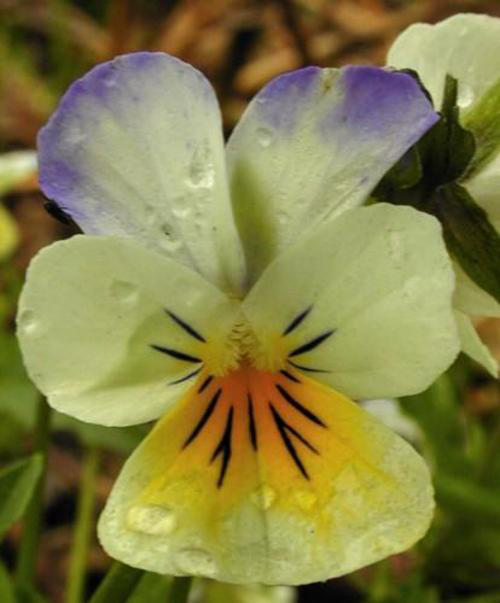

/content/dataset/dataset/images/image_sunflower_0111.png
I think this flower is a SUNFLOWER


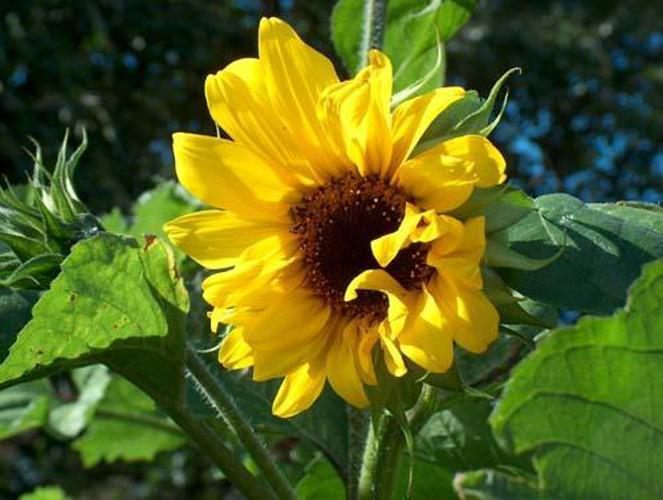

/content/dataset/dataset/images/image_pansy_0219.png
I think this flower is a PANSY


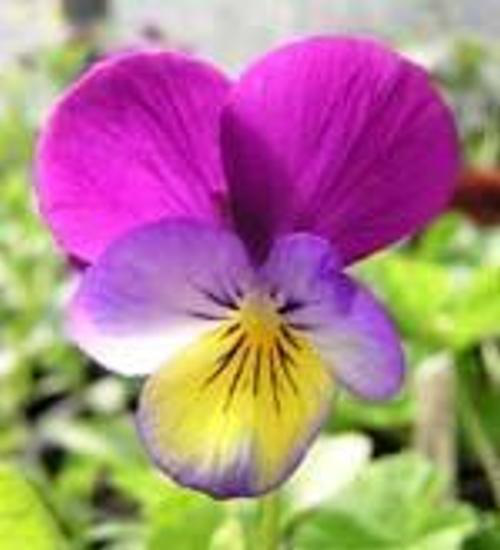

/content/dataset/dataset/images/image_daisy_0129.png
I think this flower is a DAISY


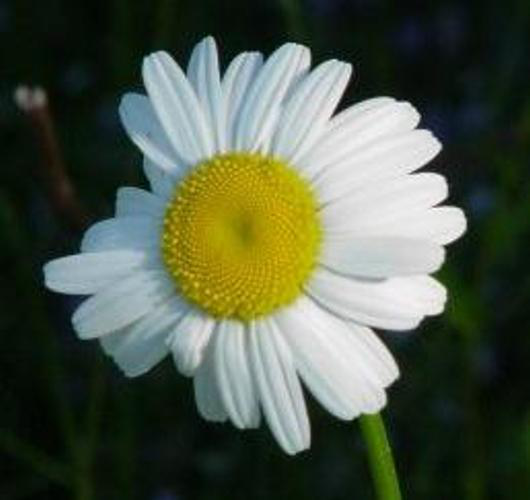

/content/dataset/dataset/images/image_daisy_0135.png
I think this flower is a DAISY


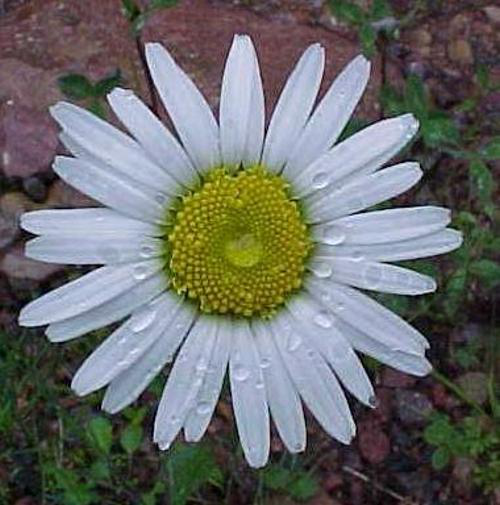

/content/dataset/dataset/images/image_daisy_0150.png
I think this flower is a DAISY


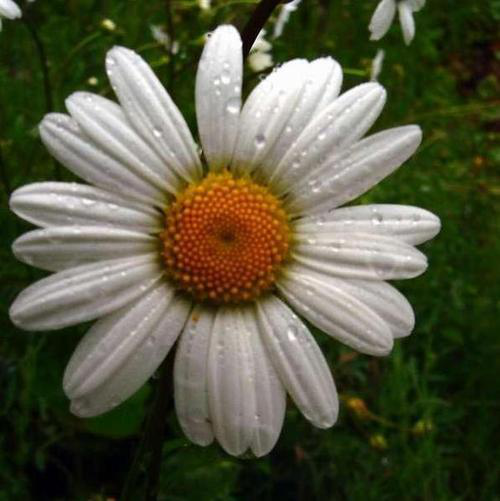

/content/dataset/dataset/images/image_crocus_0022.png
I think this flower is a CROCUS


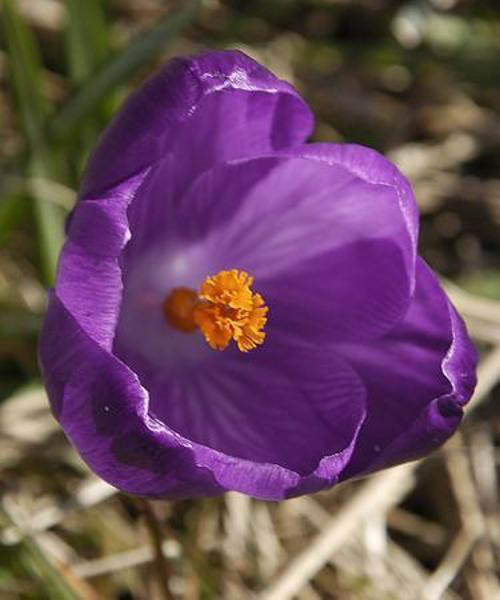

/content/dataset/dataset/images/image_crocus_0037.png
I think this flower is a DAISY


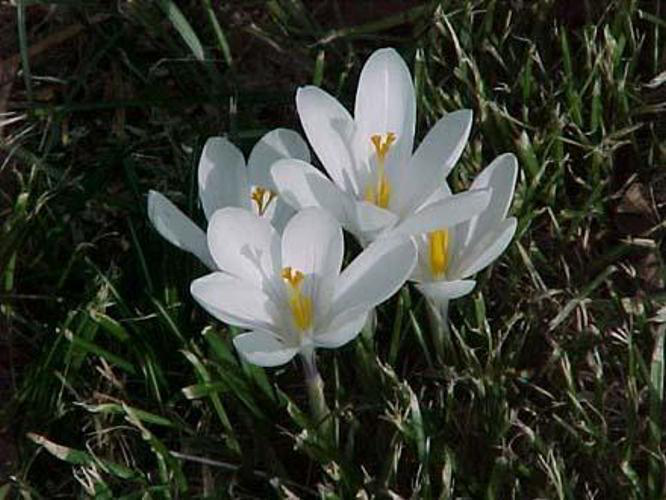

/content/dataset/dataset/images/image_crocus_0033.png
I think this flower is a DAISY


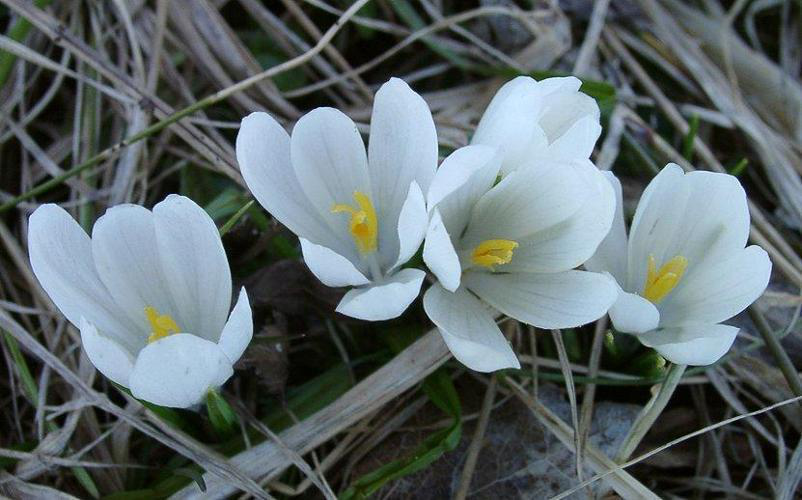

/content/dataset/dataset/images/image_pansy_0208.png
I think this flower is a PANSY


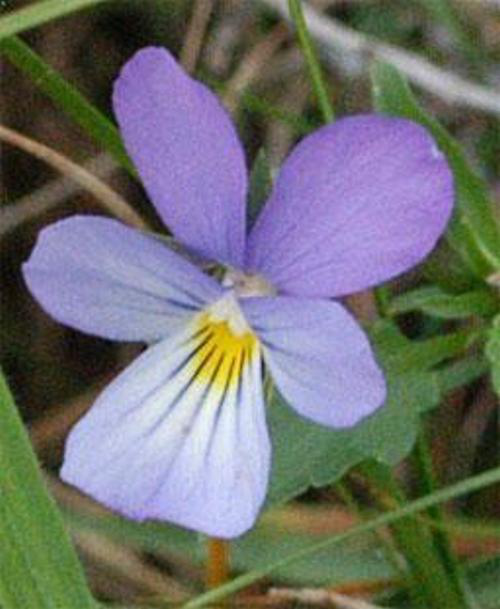

In [ ]:
# USAGE
# python classify.py --images dataset/images --masks dataset/masks

# import the necessary packages
from __future__ import print_function
from component.rgbhistogram import RGBHistogram
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import numpy as np
import argparse
import glob
import cv2
from google.colab.patches import cv2_imshow
# Import model list
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression

#@title Klasifikasi menggunakan Machine Learning
image = '/content/dataset/dataset/images' #@param
mask = '/content/dataset/dataset/masks' #@param
list_model = MultinomialNB #@param ["SVC", "RandomForestClassifier", "KNeighborsClassifier", "MultinomialNB", "DecisionTreeClassifier", "LogisticRegression"] {type:"raw"}
#@markdown ---


# grab the image and mask paths
imagePaths = sorted(glob.glob(image + "/*.png"))
maskPaths = sorted(glob.glob(mask + "/*.png"))

# initialize the list of data and class label targets
data = []
target = []

# initialize the image descriptor
desc = RGBHistogram([8, 8, 8])

# loop over the image and mask paths
for (imagePath, maskPath) in zip(imagePaths, maskPaths):
	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# update the list of data and targets
	data.append(features)
	target.append(imagePath.split("_")[-2])

# grab the unique target names and encode the labels
targetNames = np.unique(target)
le = LabelEncoder()
target = le.fit_transform(target)

# construct the training and testing splits
(trainData, testData, trainTarget, testTarget) = train_test_split(data, target,
	test_size = 0.3, random_state = 42)


# train the classifier
model = list_model()
model.fit(trainData, trainTarget)

# evaluate the classifier
print(classification_report(testTarget, model.predict(testData),
	target_names = targetNames))

# loop over a sample of the images
for i in np.random.choice(np.arange(0, len(imagePaths)), 10):
	# grab the image and mask paths
	imagePath = imagePaths[i]
	maskPath = maskPaths[i]

	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# predict what type of flower the image is
	flower = le.inverse_transform(model.predict([features]))[0]
	print(imagePath)
	print("I think this flower is a {}".format(flower.upper()))
	cv2_imshow(image)
	cv2.waitKey(0)

              precision    recall  f1-score   support

      crocus       0.73      0.92      0.81        12
       daisy       0.59      0.87      0.70        15
       pansy       0.93      0.70      0.80        20
   sunflower       0.95      0.75      0.84        24

    accuracy                           0.79        71
   macro avg       0.80      0.81      0.79        71
weighted avg       0.83      0.79      0.79        71

/content/dataset/dataset/images/image_pansy_0182.png
I think this flower is a PANSY


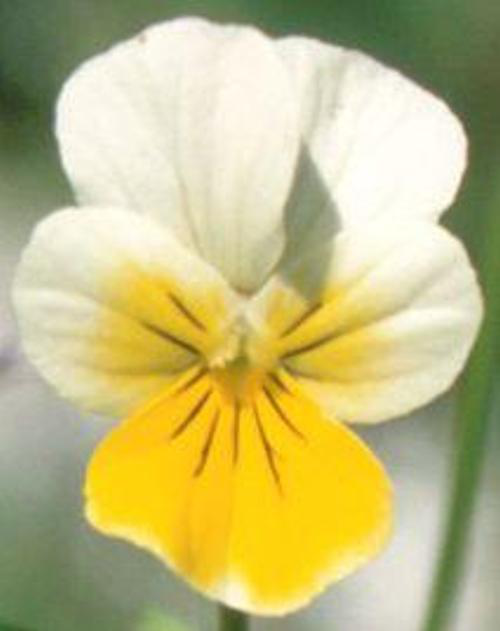

/content/dataset/dataset/images/image_pansy_0221.png
I think this flower is a PANSY


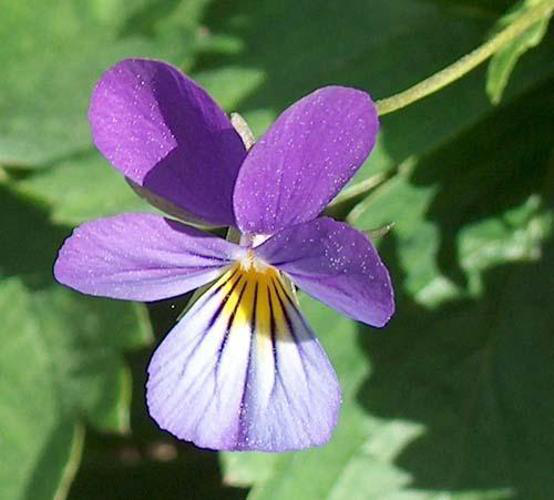

/content/dataset/dataset/images/image_sunflower_0080.png
I think this flower is a SUNFLOWER


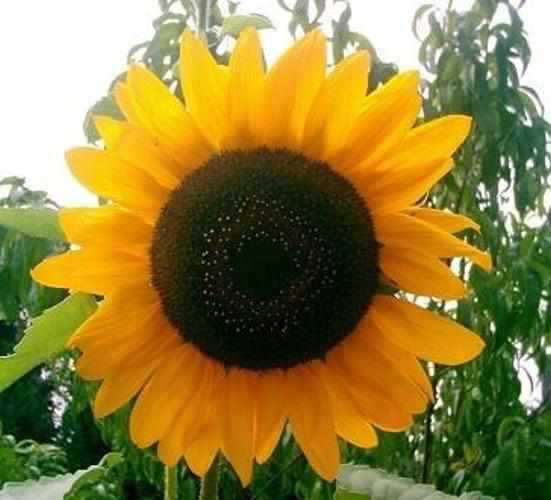

/content/dataset/dataset/images/image_daisy_0152.png
I think this flower is a DAISY


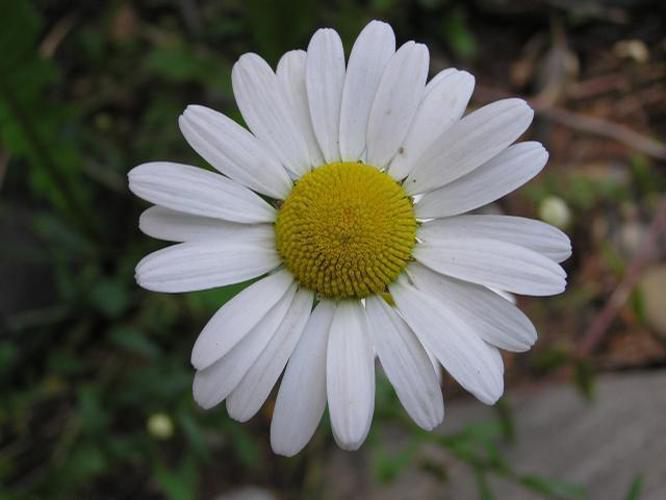

/content/dataset/dataset/images/image_daisy_0148.png
I think this flower is a DAISY


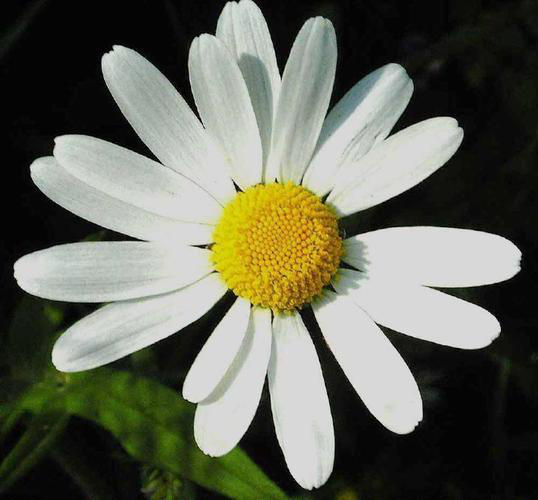

/content/dataset/dataset/images/image_pansy_0216.png
I think this flower is a PANSY


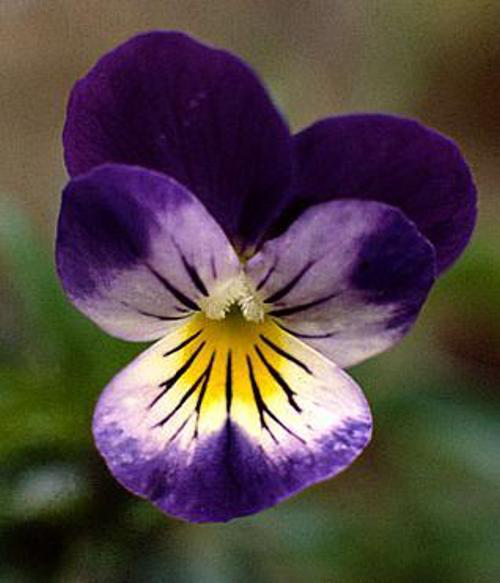

/content/dataset/dataset/images/image_sunflower_0060.png
I think this flower is a SUNFLOWER


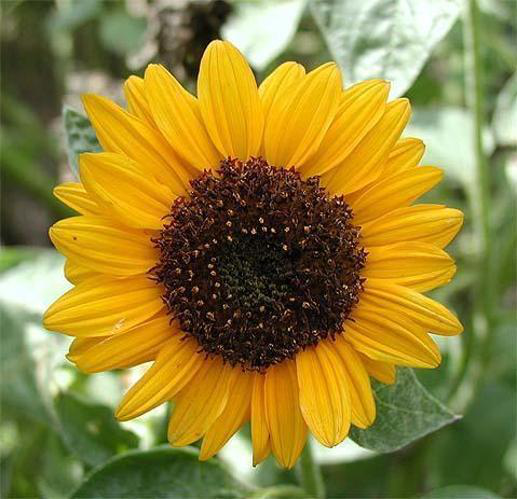

/content/dataset/dataset/images/image_pansy_0203.png
I think this flower is a PANSY


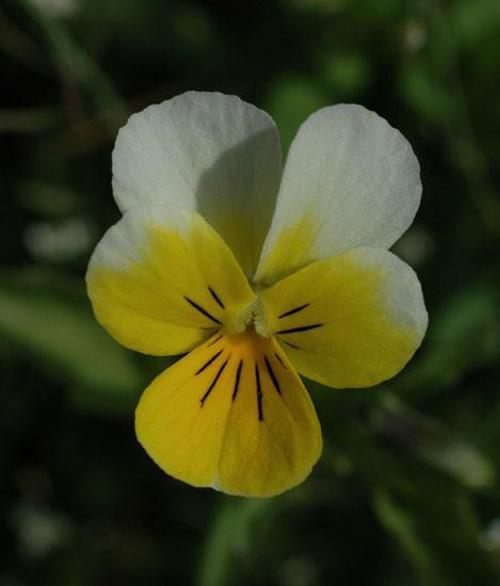

/content/dataset/dataset/images/image_sunflower_0077.png
I think this flower is a SUNFLOWER


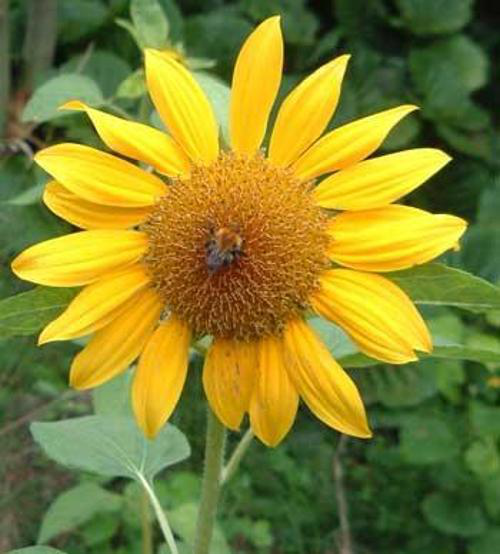

/content/dataset/dataset/images/image_crocus_0010.png
I think this flower is a CROCUS


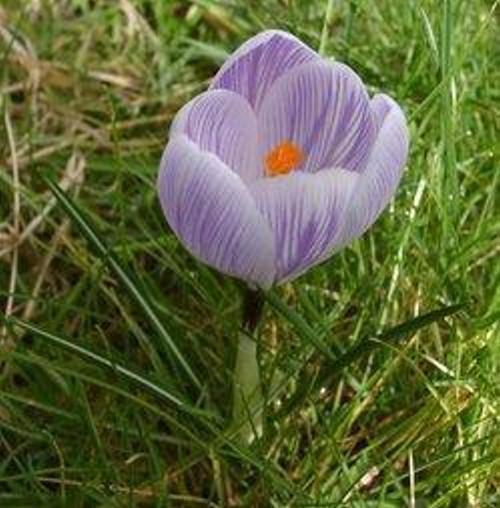

In [ ]:
# USAGE
# python classify.py --images dataset/images --masks dataset/masks

# import the necessary packages
from __future__ import print_function
from component.rgbhistogram import RGBHistogram
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import numpy as np
import argparse
import glob
import cv2
from google.colab.patches import cv2_imshow
# Import model list
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression

#@title Klasifikasi menggunakan Machine Learning
image = '/content/dataset/dataset/images' #@param
mask = '/content/dataset/dataset/masks' #@param
list_model = DecisionTreeClassifier #@param ["SVC", "RandomForestClassifier", "KNeighborsClassifier", "MultinomialNB", "DecisionTreeClassifier", "LogisticRegression"] {type:"raw"}
#@markdown ---


# grab the image and mask paths
imagePaths = sorted(glob.glob(image + "/*.png"))
maskPaths = sorted(glob.glob(mask + "/*.png"))

# initialize the list of data and class label targets
data = []
target = []

# initialize the image descriptor
desc = RGBHistogram([8, 8, 8])

# loop over the image and mask paths
for (imagePath, maskPath) in zip(imagePaths, maskPaths):
	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# update the list of data and targets
	data.append(features)
	target.append(imagePath.split("_")[-2])

# grab the unique target names and encode the labels
targetNames = np.unique(target)
le = LabelEncoder()
target = le.fit_transform(target)

# construct the training and testing splits
(trainData, testData, trainTarget, testTarget) = train_test_split(data, target,
	test_size = 0.3, random_state = 42)


# train the classifier
model = list_model()
model.fit(trainData, trainTarget)

# evaluate the classifier
print(classification_report(testTarget, model.predict(testData),
	target_names = targetNames))

# loop over a sample of the images
for i in np.random.choice(np.arange(0, len(imagePaths)), 10):
	# grab the image and mask paths
	imagePath = imagePaths[i]
	maskPath = maskPaths[i]

	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# predict what type of flower the image is
	flower = le.inverse_transform(model.predict([features]))[0]
	print(imagePath)
	print("I think this flower is a {}".format(flower.upper()))
	cv2_imshow(image)
	cv2.waitKey(0)

              precision    recall  f1-score   support

      crocus       0.54      0.58      0.56        12
       daisy       0.87      0.87      0.87        15
       pansy       0.82      0.70      0.76        20
   sunflower       0.92      1.00      0.96        24

    accuracy                           0.82        71
   macro avg       0.79      0.79      0.79        71
weighted avg       0.82      0.82      0.82        71

/content/dataset/dataset/images/image_crocus_0032.png
I think this flower is a CROCUS


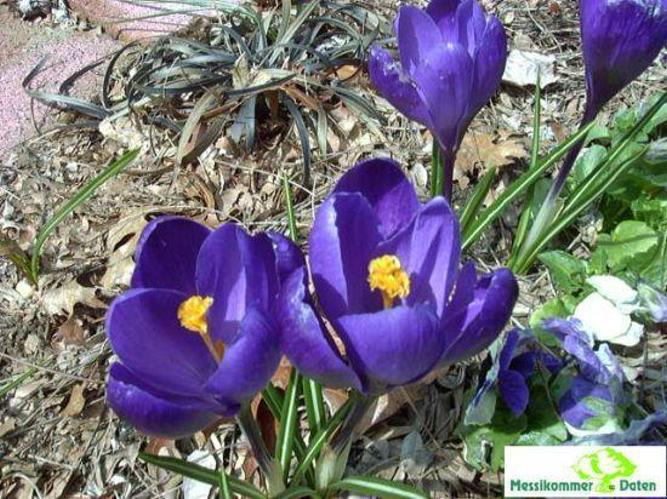

/content/dataset/dataset/images/image_sunflower_0112.png
I think this flower is a SUNFLOWER


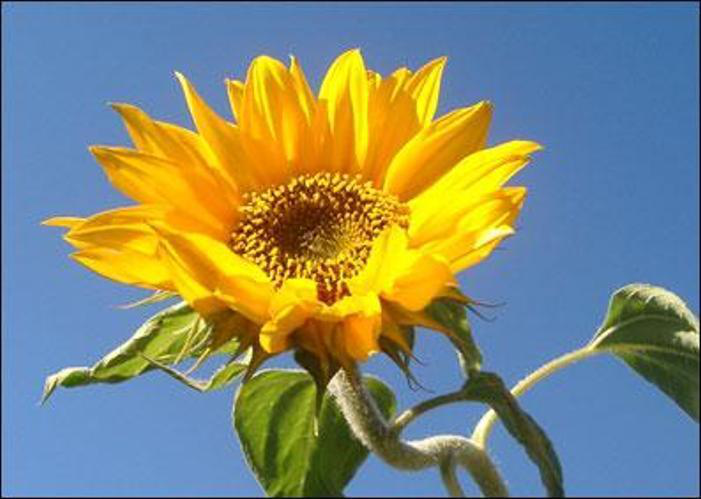

/content/dataset/dataset/images/image_daisy_0144.png
I think this flower is a DAISY


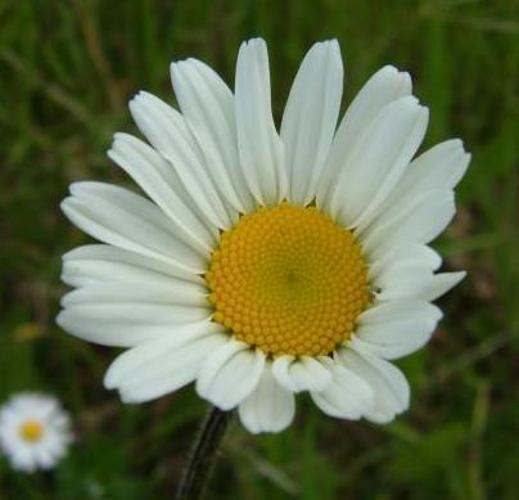

/content/dataset/dataset/images/image_pansy_0223.png
I think this flower is a PANSY


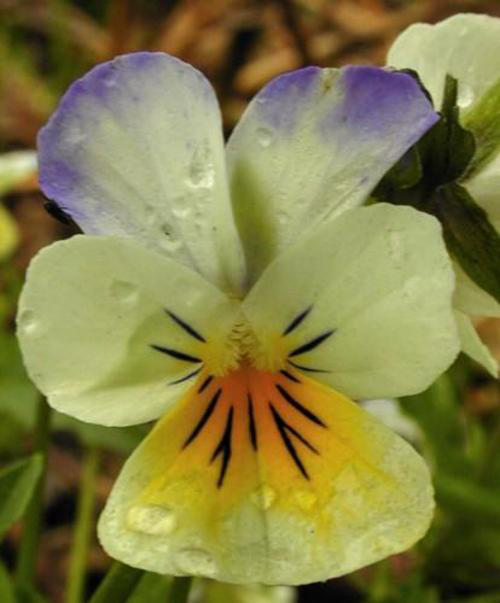

/content/dataset/dataset/images/image_sunflower_0119.png
I think this flower is a SUNFLOWER


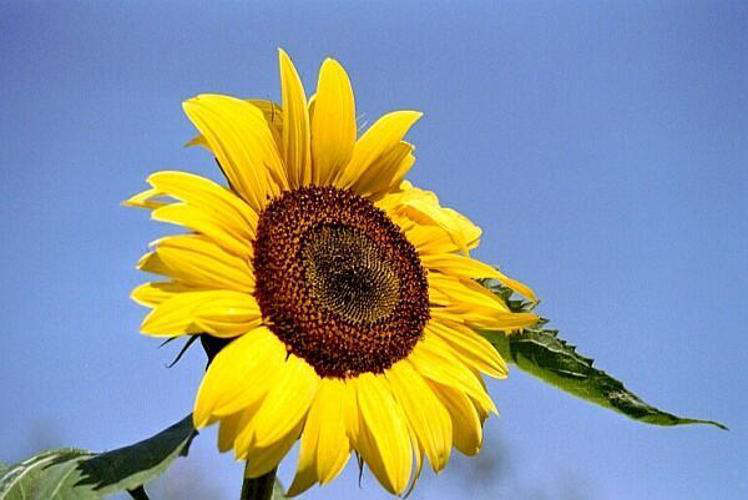

/content/dataset/dataset/images/image_pansy_0189.png
I think this flower is a PANSY


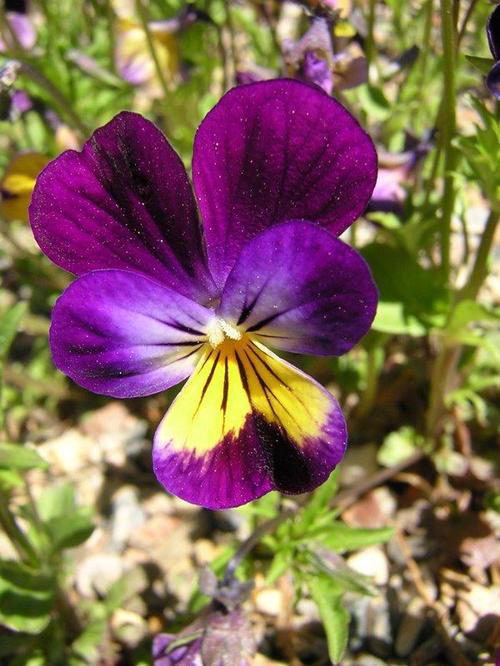

/content/dataset/dataset/images/image_sunflower_0062.png
I think this flower is a SUNFLOWER


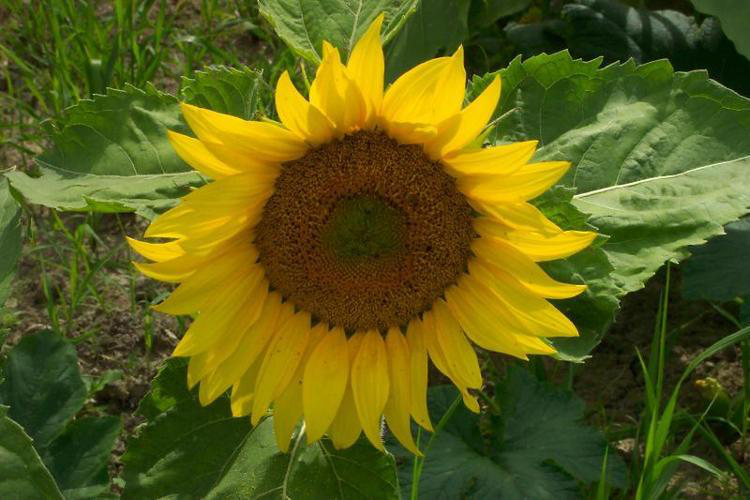

/content/dataset/dataset/images/image_pansy_0228.png
I think this flower is a PANSY


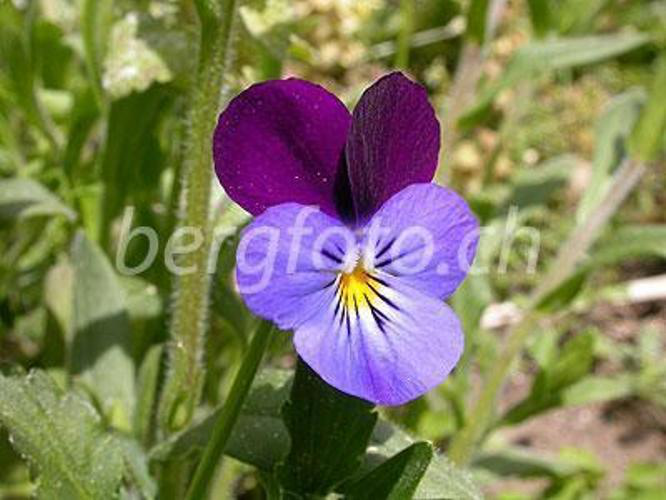

/content/dataset/dataset/images/image_pansy_0213.png
I think this flower is a PANSY


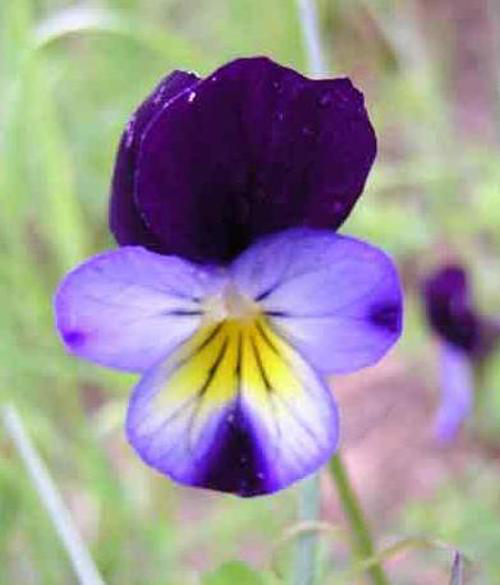

/content/dataset/dataset/images/image_pansy_0190.png
I think this flower is a PANSY


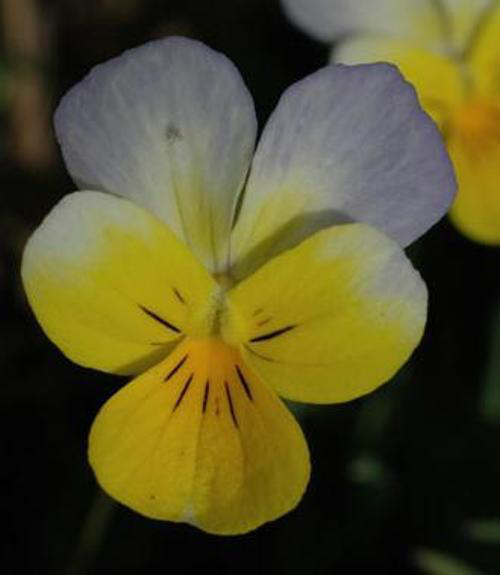

In [ ]:
# USAGE
# python classify.py --images dataset/images --masks dataset/masks

# import the necessary packages
from __future__ import print_function
from component.rgbhistogram import RGBHistogram
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import numpy as np
import argparse
import glob
import cv2
from google.colab.patches import cv2_imshow
# Import model list
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression

#@title Klasifikasi menggunakan Machine Learning
image = '/content/dataset/dataset/images' #@param
mask = '/content/dataset/dataset/masks' #@param
list_model = LogisticRegression #@param ["SVC", "RandomForestClassifier", "KNeighborsClassifier", "MultinomialNB", "DecisionTreeClassifier", "LogisticRegression"] {type:"raw"}
#@markdown ---


# grab the image and mask paths
imagePaths = sorted(glob.glob(image + "/*.png"))
maskPaths = sorted(glob.glob(mask + "/*.png"))

# initialize the list of data and class label targets
data = []
target = []

# initialize the image descriptor
desc = RGBHistogram([8, 8, 8])

# loop over the image and mask paths
for (imagePath, maskPath) in zip(imagePaths, maskPaths):
	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# update the list of data and targets
	data.append(features)
	target.append(imagePath.split("_")[-2])

# grab the unique target names and encode the labels
targetNames = np.unique(target)
le = LabelEncoder()
target = le.fit_transform(target)

# construct the training and testing splits
(trainData, testData, trainTarget, testTarget) = train_test_split(data, target,
	test_size = 0.3, random_state = 42)


# train the classifier
model = list_model()
model.fit(trainData, trainTarget)

# evaluate the classifier
print(classification_report(testTarget, model.predict(testData),
	target_names = targetNames))

# loop over a sample of the images
for i in np.random.choice(np.arange(0, len(imagePaths)), 10):
	# grab the image and mask paths
	imagePath = imagePaths[i]
	maskPath = maskPaths[i]

	# load the image and mask
	image = cv2.imread(imagePath)
	mask = cv2.imread(maskPath)
	mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)

	# describe the image
	features = desc.describe(image, mask)

	# predict what type of flower the image is
	flower = le.inverse_transform(model.predict([features]))[0]
	print(imagePath)
	print("I think this flower is a {}".format(flower.upper()))
	cv2_imshow(image)
	cv2.waitKey(0)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
path = '/content/drive/MyDrive/Python/KMMI/case_study/case_study2'

for dirpath, dirnames, filenames in os.walk(path):
  print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

There are 1 directories and 0 images in '/content/drive/MyDrive/Python/KMMI/case_study/case_study2'.
There are 4 directories and 0 images in '/content/drive/MyDrive/Python/KMMI/case_study/case_study2/images'.
There are 0 directories and 50 images in '/content/drive/MyDrive/Python/KMMI/case_study/case_study2/images/crocus'.
There are 0 directories and 57 images in '/content/drive/MyDrive/Python/KMMI/case_study/case_study2/images/daisy'.
There are 0 directories and 56 images in '/content/drive/MyDrive/Python/KMMI/case_study/case_study2/images/pansy'.
There are 0 directories and 71 images in '/content/drive/MyDrive/Python/KMMI/case_study/case_study2/images/sunflower'.


In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras import layers
from tensorflow.keras.layers.experimental import preprocessing
from tensorflow.keras.models import Sequential
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.resnet50 import ResNet50

data_dir = "/content/drive/MyDrive/Python/KMMI/case_study/case_study2/images"
BATCH_SIZE = 16
SEED = 42

# digunakan 80% data untuk training dan 20% untuk testing
train_data = image_dataset_from_directory(data_dir, shuffle=True, batch_size=BATCH_SIZE,
                                          subset='training', label_mode='categorical', seed=SEED,
                                          validation_split=0.2, image_size=(256, 256))
test_data = image_dataset_from_directory(data_dir, shuffle=False, batch_size=BATCH_SIZE,
                                          subset='validation', label_mode='categorical', seed=SEED,
                                         validation_split=0.2, image_size=(256, 256))

Found 234 files belonging to 4 classes.
Using 188 files for training.
Found 234 files belonging to 4 classes.
Using 46 files for validation.


In [ ]:
class_names = train_data.class_names
class_names

['crocus', 'daisy', 'pansy', 'sunflower']

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE
# data dicache dan diprefetch untuk mempercepat proses pengambilan data
# sehingga proses training juga menjadi lebih cepat
train_ds = train_data.cache().prefetch(buffer_size=AUTOTUNE)
test_ds = test_data.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
# definisikan layer data augmentasi
data_augmentation = Sequential([
  preprocessing.RandomFlip("horizontal"), 
  preprocessing.RandomRotation(0.2), 
  preprocessing.RandomHeight(0.2),
  preprocessing.RandomWidth(0.2), 
  preprocessing.RandomZoom(0.2), 
], name="data_augmentation")

In [ ]:
# Transfer learning hanya untuk feature extractor saja
# maka layer difreeze dan training diFalse

base_model = VGG16(include_top=False)
base_model.trainable = False


inputs = layers.Input(shape=(256, 256, 3), name="input_layer") # Definisikan input size
x = data_augmentation(inputs) # digunakan data augmentasi menggunakan sequential layer di atas
x = base_model(x, training=False) # 
x = layers.GlobalAveragePooling2D(name="global_average_pooling")(x) # digunakan pooling layer untuk mengurangi overfit
outputs = layers.Dense(4, activation="softmax", name="output_layer")(x) # 4 kelas dense layer
model = tf.keras.Model(inputs, outputs)

In [ ]:
# Compile
EPOCHS = 5
model.compile(loss="categorical_crossentropy",
              optimizer=tf.keras.optimizers.Adam(), # Pakai default setting saja
              metrics=["accuracy"])

# Fit
history1 = model.fit(train_data, epochs=EPOCHS, validation_data=test_data,
                     validation_steps=len(test_data))

Epoch 1/5
12/12 [==============================] - 172s 15s/step - loss: 3.2481 - accuracy: 0.3989 - val_loss: 1.0869 - val_accuracy: 0.7174
Epoch 2/5
12/12 [==============================] - 167s 14s/step - loss: 1.4479 - accuracy: 0.6330 - val_loss: 0.6621 - val_accuracy: 0.7391
Epoch 3/5
12/12 [==============================] - 166s 14s/step - loss: 0.6922 - accuracy: 0.7872 - val_loss: 0.1762 - val_accuracy: 0.8696
Epoch 4/5
12/12 [==============================] - 163s 14s/step - loss: 0.4192 - accuracy: 0.8564 - val_loss: 0.4340 - val_accuracy: 0.8261
Epoch 5/5
12/12 [==============================] - 161s 13s/step - loss: 0.2741 - accuracy: 0.8883 - val_loss: 0.3634 - val_accuracy: 0.8913


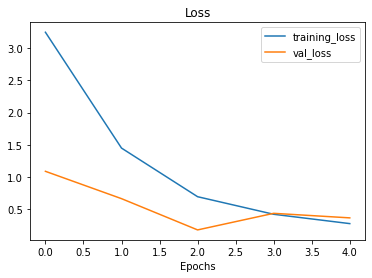

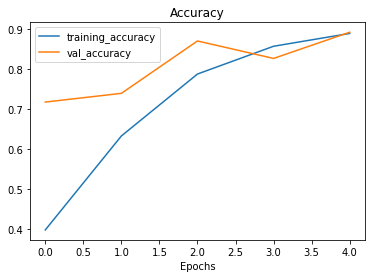

In [ ]:
import matplotlib.pyplot as plt

def plot_loss_curves(history):
  """
  Returns separate loss curves for training and validation metrics.
  Args:
    history: TensorFlow model History object (see: https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/History)
  """ 
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  accuracy = history.history['accuracy']
  val_accuracy = history.history['val_accuracy']

  epochs = range(len(history.history['loss']))

  # Plot loss
  plt.plot(epochs, loss, label='training_loss')
  plt.plot(epochs, val_loss, label='val_loss')
  plt.title('Loss')
  plt.xlabel('Epochs')
  plt.legend()

  # Plot accuracy
  plt.figure()
  plt.plot(epochs, accuracy, label='training_accuracy')
  plt.plot(epochs, val_accuracy, label='val_accuracy')
  plt.title('Accuracy')
  plt.xlabel('Epochs')
  plt.legend();

plot_loss_curves(history1)

Hasil dari model CNN sudah bagus, meskipun hanya 5 epochs saja.